# 准备

In [1]:
import time
import math
import pandas as pd
import numpy as np
import calendar
import matplotlib.pyplot as plt
import matplotlib
from sklearn.cluster import DBSCAN
matplotlib.style.use('ggplot')
%pylab inline

# 读取数据：原始用户操作数据
df_user_actions = pd.read_csv('./data/p2/p2_mars_tianchi_user_actions.csv', 
                              header = None, 
                              names = ('user_id', 'song_id', 'gmt_create', 'action_type', 'Ds'))
# 读取数据：原始歌曲信息数据
df_song_info = pd.read_csv('./data/p2/p2_mars_tianchi_songs.csv', 
                           header = None, 
                           names = ('song_id', 'artist_id', 'public_time','popular', 'language', 'gender'))
# 读取数据：按照艺人，统计每天的歌曲数据
df_daily_by_artist = pd.read_csv('./data/p2/daily_by_artist.csv', 
                             header = None, 
                             names = ['artist_id', 'date', 'play', 'download', 'like'])
# read data of daily play data divide by songs.
df_daily_by_song = pd.read_csv('./data/p2/daily_by_song.csv', 
                             header = None, 
                             names = ['song_id', 'date', 'play', 'download', 'like'])

# 构造艺人ID列表
artist_ids = list(set(df_daily_by_artist['artist_id']))
# 构造艺人所属的歌曲的ID字典
artists = {}
for i in range(0, df_song_info.shape[0]):
    artist = df_song_info.iloc[i]['artist_id']
    song = df_song_info.iloc[i]['song_id']
    if artist not in artists:
        artists[artist] = []
    artists[artist].append(song)
# 构造结果文件中的日期Series
dates_future = pd.date_range('20150901', '20151030')
dates_past = pd.date_range('20150301', '20150830')

# artist_V = ['8fb3cef29f2c266af4c9ecef3b780e97', 'c026b84e8f23a7741d9b670e3d8973f0',
#             'c5f0170f87a2fbb17bf65dc858c745e2', '03c6699ea836decbc5c8fc2dbae7bd3b', 
#             '4b8eb68442432c242e9242be040bacf9', '2e14d32266ee6b4678595f8f50c369ac']
# artist_noV = [i for i in artist_id if i not in artist_V]

df_daily_by_song_drop = pd.read_csv('./data/p2/daily_by_song_drop.csv', 
                             header = None, 
                             names = ['song_id', 'date', 'play', 'download', 'like'])

df_daily_by_artist_drop = pd.read_csv('./data/p2/daily_by_artist_drop.csv', 
                             header = None, 
                             names = ['artist_id', 'date', 'play', 'download', 'like'])

Populating the interactive namespace from numpy and matplotlib


In [201]:
# 画一首歌的曲线
def plot_song(song, kind = 'play', drop = False):
    if not drop:
        df_daily_by_song[df_daily_by_song.song_id == song][kind].plot()
    else:
        df_daily_by_song_drop[df_daily_by_song_drop.song_id == song][kind].plot()

# 对一个歌手的所有歌曲画图
def plot_artist(artist, drop = False, norm = False, pub = False, kind = 'play', figsize = (20, 10), label = None):
    if drop:
        df = df_daily_by_song_drop
    else:
        df = df_daily_by_song
    songs = artists[artist]
    fig = plt.figure(figsize = figsize)
    i = 1
    for song in songs:
        ax = fig.add_subplot(int(len(songs)/4)+1, 4, i)
        temp = df[df.song_id == song]
        temp['new_date'] = dates_past
        temp = temp.set_index(['new_date'])
        if norm:
            temp = min_max_normalization(temp[kind])
        else:
            temp = temp[kind]
        temp.plot(ax = ax)
        title = song + '\n' + str(int(df_song_info[df_song_info.song_id == song]['public_time']))
        if label:
            title += '\t' + str(label[i-1])
        ax.set_title(title)
        i += 1
    plt.subplots_adjust(wspace = 0.5, hspace = 0.9)
    return fig

# 获取某个df中这首歌的播放量
def get_daily_by_song(df, song):
    data_song = df[df.song_id == song]
    content = {'play':[], 'download':[], 'like':[], 'date':[]}
    for dates in dates_past:
        date = int(str(datetime.date(dates.year,dates.month,dates.day)).replace('-', ''))
        data_today = data_song[data_song.Ds == date]
        play = len(data_today[data_today.action_type == 1])
        download = len(data_today[data_today.action_type == 2])
        like = len(data_today[data_today.action_type == 3])
        content['play'].append(play)
        content['download'].append(download)
        content['like'].append(like)
        content['date'].append(date)
    content['song_id'] = song
    content = pd.DataFrame(content)
    return content

# 从字符串类型的“年月日”格式日起中获取星期
def get_wday_from_date(time_value):
    return datetime.datetime.strptime(str(time_value),'%Y%m%d').weekday()+1

# 对Series数据进行归一化处理
def min_max_normalization(data):
    _min = data.min()
    _max = data.max()
    return data.apply(lambda x: double(x - _min) / double(_max - _min))

# 比较两首歌曲的DataFrame之间的差距
def song_distance(song1, song2):
    return (song1 - song2).abs().sum()    


# 用两天之间的上下走势，比较两首歌曲的DataFrame之间的差距
def song_distance2(song1, song2):
    trend1 = []
    for i in range(len(song1)-1):
        trend1.append(song1[i+1] - song1[i])
    trend2 = []
    for i in range(len(song2)-1):
        trend2.append(song2[i+1] - song2[i])
    trend1 = pd.Series(data = trend1)
    trend2 = pd.Series(data = trend2)
    return (trend1 - trend2).abs().sum()   

# dbscan计算距离metrics
def song_metric(x, y):
    i, j = int(x[0]), int(y[0])
    _distance =  song_distance(song_for_distance[i], song_for_distance[j])
    return _distance
def song_metric2(x, y):
    i, j = int(x[0]), int(y[0])
    _distance =  song_distance2(song_for_distance[i], song_for_distance[j])
    return _distance

# 根据最近邻方法进行聚类
def neighbor_cluster(artist, kind = 1, rolling = 1):
    cluster = []
    try:
        song_list = artists[artist]
    except KeyError as e:
        print 'artist_id not exist!'
        return cluster
        
    song_for_distance = []
    for song in song_list:
        song = df_daily_by_song_drop[df_daily_by_song_drop.song_id == song]['play']
        song = min_max_normalization(song).reset_index(drop = True)
        if rolling > 1:
            song = song.rolling(window = rolling).mean().fillna(0.0)
        song_for_distance.append(song)
        
    neighbor = []
    length = len(song_for_distance)
    if kind == 1:
        distance_method = song_distance
    if kind == 2:
        distance_method = song_distance2
    for i in range(length):
        temp = 99999
        neighbor.append(-1)
        for j in range(length):
            distance = distance_method(song_for_distance[i], song_for_distance[j])
            if (distance < temp ) and (i != j):
                temp = distance
                neighbor[i] = j
    
    cluster.append([0, neighbor[0]])
    for i in range(1, length):
        flag = 0
        for j in range(len(cluster)):
            if (i in cluster[j]):
                cluster[j].append(neighbor[i])
                flag = 1
            if (neighbor[i] in cluster[j]):
                cluster[j].append(i)
                flag = 1
        if flag == 0:
            cluster.append([i, neighbor[i]])
            
    for i in range(len(cluster)):
        cluster[i] = list(set(cluster[i]))
    label = []
    for i in range(length):
        for j in range(len(cluster)):
            if i in cluster[j]:
                label.append(j)
    return cluster, label, neighbor

In [ ]:
df_song_info[df_song_info.artist_id == '8fb3cef29f2c266af4c9ecef3b780e97']

尝试将同一个艺人的歌曲进行聚类分析

大户：cd5ce8f47e50971ddb629d86a0bc34f2

中户：8fb3cef29f2c266af4c9ecef3b780e97

小户：cbc53d8b2da2e34974c29b7fc6534444

cluster:  [[0, 2, 11, 10, 21], [1, 18, 4, 15], [3, 14], [9, 5], [1, 18, 6], [17, 13, 7], [8, 10, 11, 21], [16, 20, 19, 12], [16, 19, 20]]
label:  [0, 1, 4, 0, 2, 1, 3, 4, 5, 6, 3, 0, 6, 0, 6, 7, 5, 2, 1, 7, 8, 5, 1, 4, 7, 8, 7, 8, 0, 6]


/home/yli/anaconda2/lib/python2.7/site-packages/ipykernel/__main__.py:20: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: http://pandas.pydata.org/pandas-docs/stable/indexing.html#indexing-view-versus-copy


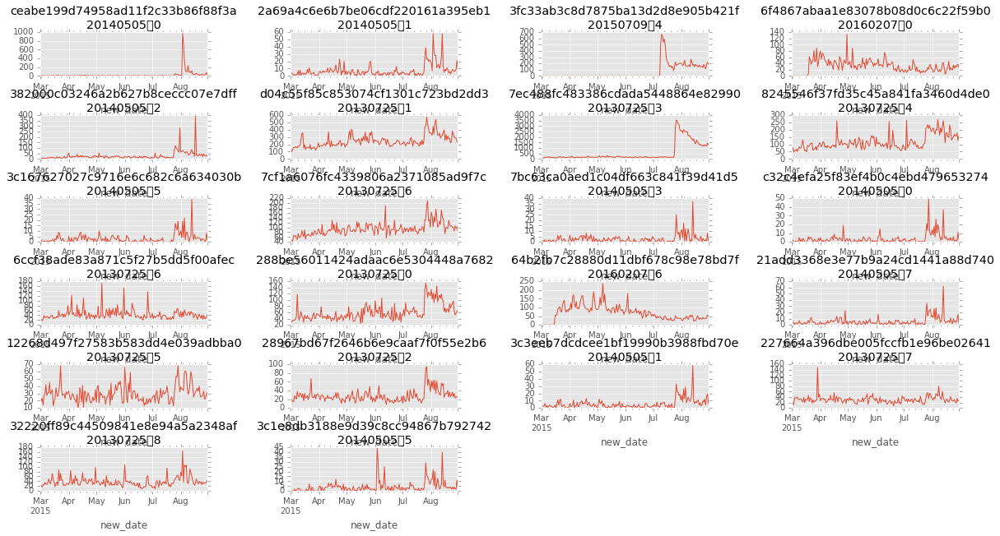

In [202]:
cluster, label, neighbor = neighbor_cluster('8fb3cef29f2c266af4c9ecef3b780e97', kind = 1, rolling = 3)

print 'cluster: ', cluster
print 'label: ', label

fig = plot_artist('8fb3cef29f2c266af4c9ecef3b780e97', label = label)

In [203]:
print 'neighbor', neighbor

neighbor [11, 15, 0, 14, 1, 9, 18, 13, 10, 5, 8, 10, 19, 17, 3, 1, 20, 13, 1, 16, 16, 11]


/home/yli/anaconda2/lib/python2.7/site-packages/ipykernel/__main__.py:20: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: http://pandas.pydata.org/pandas-docs/stable/indexing.html#indexing-view-versus-copy


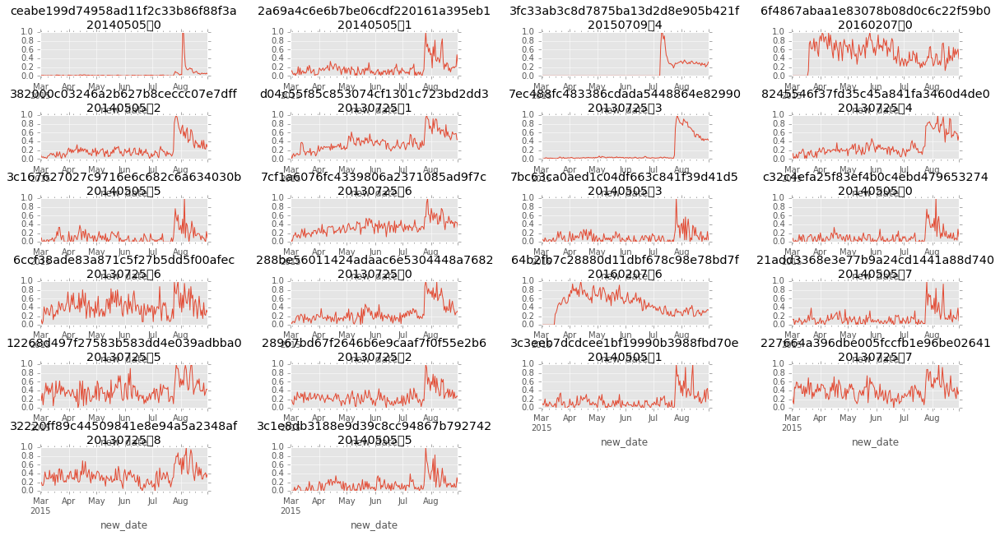

In [204]:
fig = plot_artist('8fb3cef29f2c266af4c9ecef3b780e97', norm = True, drop = True, label = label)

/home/yli/anaconda2/lib/python2.7/site-packages/ipykernel/__main__.py:20: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: http://pandas.pydata.org/pandas-docs/stable/indexing.html#indexing-view-versus-copy


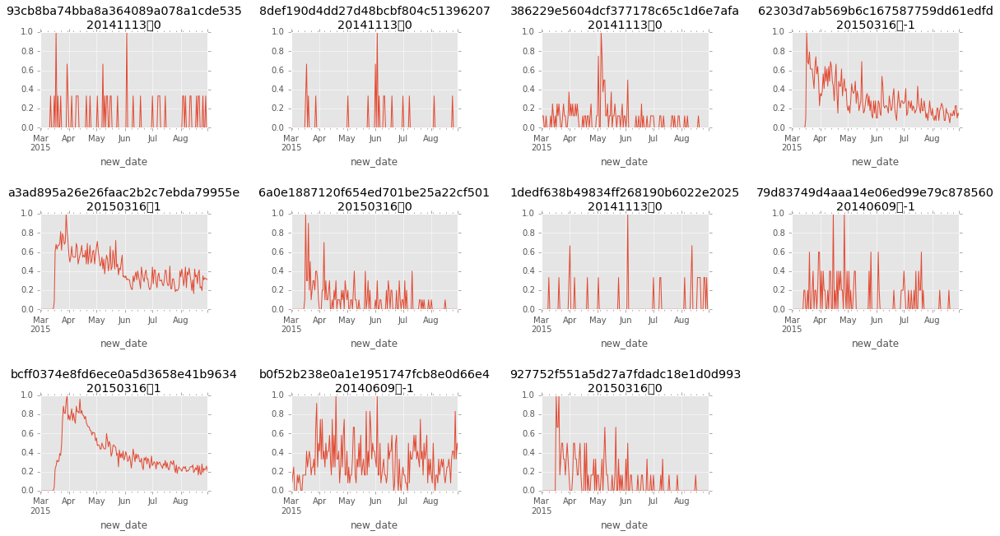

In [92]:
# 直接使用DBSCAN方法，缺点：无法准确确定eps
song_list = artists['cbc53d8b2da2e34974c29b7fc6534444']
song_for_distance = []
for song in song_list:
    song = df_daily_by_song_drop[df_daily_by_song_drop.song_id == song]['play']
    song = min_max_normalization(song).reset_index(drop = True)
    song_for_distance.append(song)
    
X = np.arange(len(song_for_distance)).reshape(-1, 1)
db = DBSCAN(metric=song_metric,eps = 20, min_samples=2).fit(X)

fig = plot_artist('cbc53d8b2da2e34974c29b7fc6534444', drop = True, norm = True, label = list(db.labels_))

cluster:  [[0, 1, 2, 6], [8, 9, 3, 4], [10, 5, 7]]
label:  [0, 0, 0, 1, 1, 2, 0, 2, 1, 1, 2]


/home/yli/anaconda2/lib/python2.7/site-packages/ipykernel/__main__.py:20: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: http://pandas.pydata.org/pandas-docs/stable/indexing.html#indexing-view-versus-copy


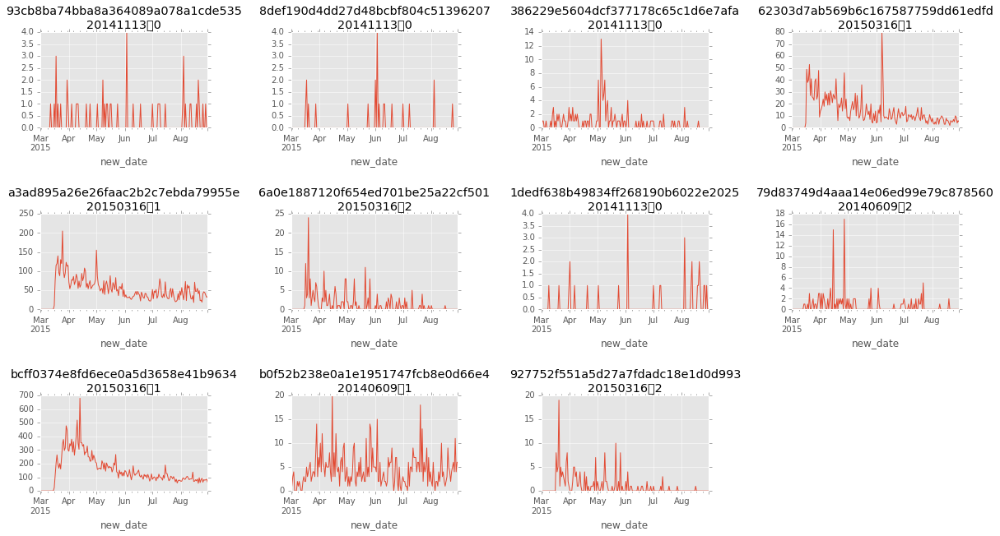

In [160]:
# 使用最近邻方法聚类，距离计算方式为song_distance
cluster, label = neighbor_cluster(song_for_distance, kind = 1)

print 'cluster: ', cluster
print 'label: ', label

fig = plot_artist('cbc53d8b2da2e34974c29b7fc6534444', label = label)

cluster:  [[0, 1, 6], [2, 3, 4, 7, 8, 9], [10, 5]]
label:  [0, 0, 1, 1, 1, 2, 0, 1, 1, 1, 2]


/home/yli/anaconda2/lib/python2.7/site-packages/ipykernel/__main__.py:20: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: http://pandas.pydata.org/pandas-docs/stable/indexing.html#indexing-view-versus-copy


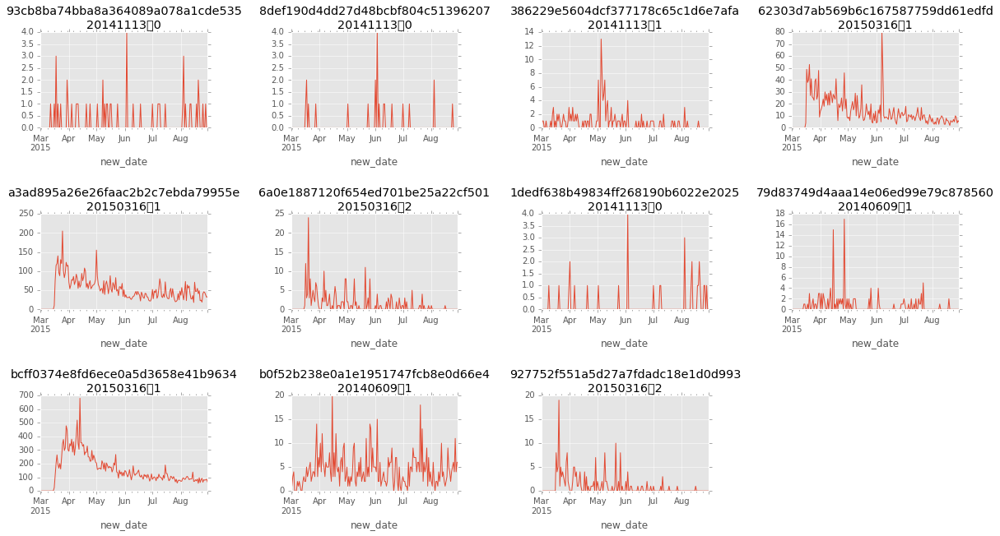

In [161]:
# 使用最近邻方法聚类，距离计算方式为song_distance2
cluster, label = neighbor_cluster(song_for_distance, kind = 2)

print 'cluster: ', cluster
print 'label: ', label

fig = plot_artist('cbc53d8b2da2e34974c29b7fc6534444', label = label)

cluster:  [[0, 2, 6], [1, 18, 4, 15], [3, 14], [9, 5], [17, 20, 13, 7], [8, 10, 11, 21], [20, 19, 12, 17], [16, 17, 19, 20]]
label:  [0, 1, 0, 2, 1, 3, 0, 4, 5, 3, 5, 5, 6, 4, 2, 1, 7, 4, 6, 7, 1, 6, 7, 4, 6, 7, 5]


/home/yli/anaconda2/lib/python2.7/site-packages/ipykernel/__main__.py:20: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: http://pandas.pydata.org/pandas-docs/stable/indexing.html#indexing-view-versus-copy


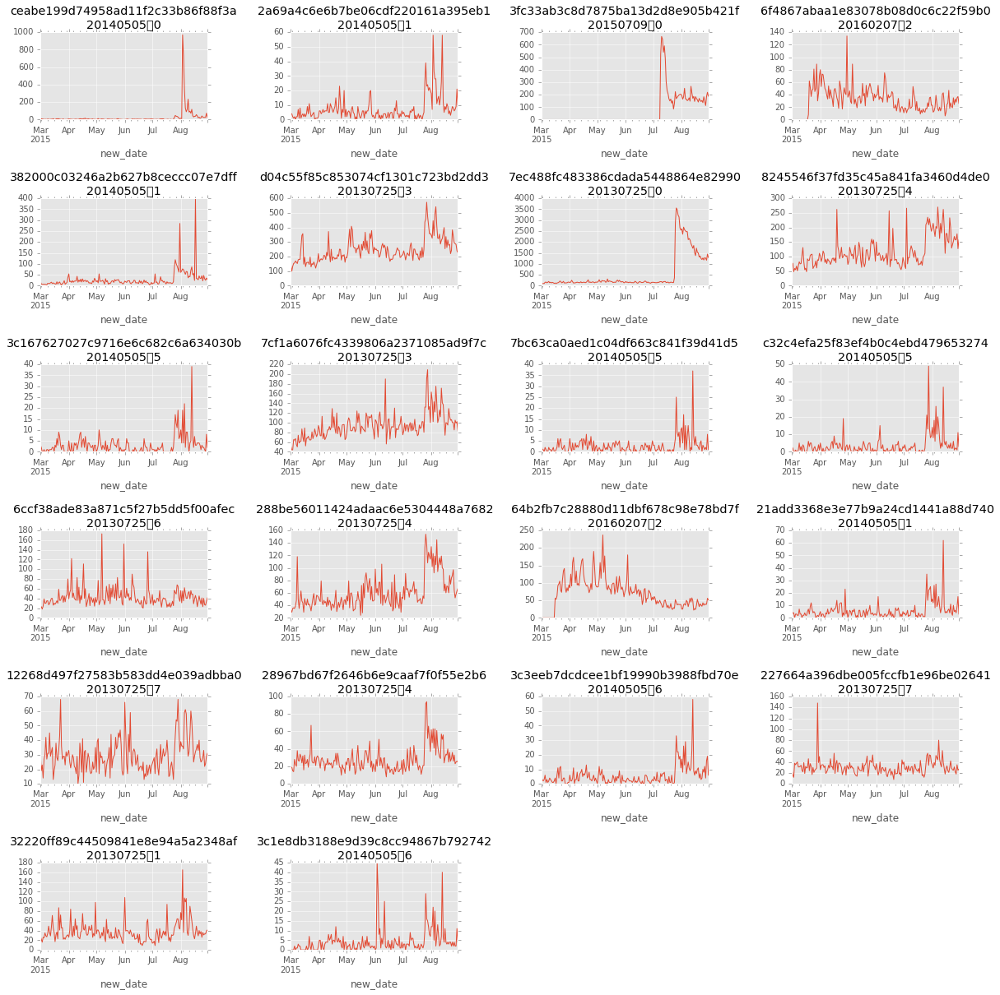

In [162]:
song_list = artists['8fb3cef29f2c266af4c9ecef3b780e97']
song_for_distance = []
for song in song_list:
    song = df_daily_by_song_drop[df_daily_by_song_drop.song_id == song]['play']
    song = min_max_normalization(song).reset_index(drop = True)
    song_for_distance.append(song)
    
cluster, label = neighbor_cluster(song_for_distance, kind = 1)

print 'cluster: ', cluster
print 'label: ', label

fig = plot_artist('8fb3cef29f2c266af4c9ecef3b780e97', figsize = (20, 20), label = label)

/home/yli/anaconda2/lib/python2.7/site-packages/ipykernel/__main__.py:20: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: http://pandas.pydata.org/pandas-docs/stable/indexing.html#indexing-view-versus-copy


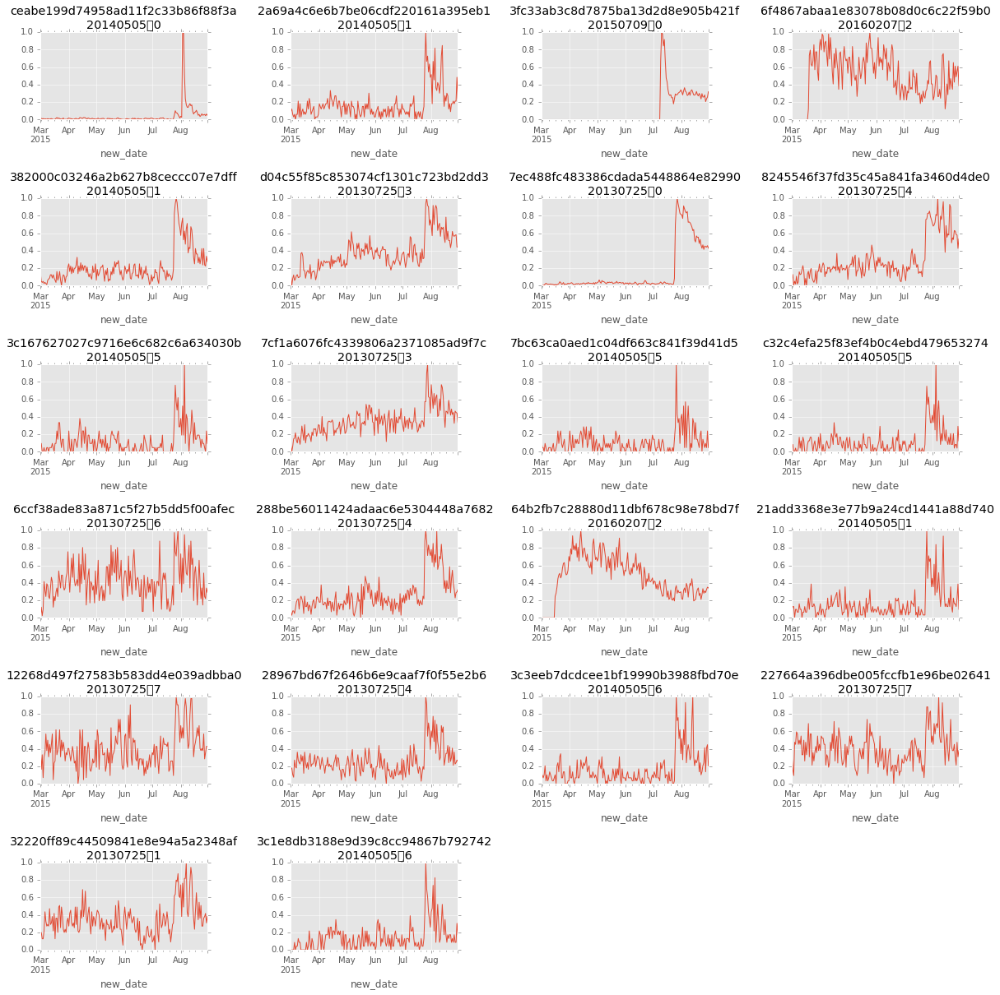

In [163]:
fig = plot_artist('8fb3cef29f2c266af4c9ecef3b780e97', figsize = (20, 20), label = label, norm = True, drop = True)

In [193]:
rolmean = song_for_distance[1].rolling(window = 20).mean()

In [195]:
rolmean.fillna(0.0)

0      0.000000
1      0.000000
2      0.000000
3      0.000000
4      0.000000
5      0.000000
6      0.000000
7      0.000000
8      0.000000
9      0.000000
10     0.000000
11     0.000000
12     0.000000
13     0.000000
14     0.000000
15     0.000000
16     0.000000
17     0.000000
18     0.000000
19     0.089394
20     0.096970
21     0.100000
22     0.100000
23     0.103030
24     0.106061
25     0.113636
26     0.110606
27     0.109091
28     0.100000
29     0.100000
         ...   
153    0.307576
154    0.303030
155    0.336364
156    0.354545
157    0.395455
158    0.410606
159    0.422727
160    0.442424
161    0.457576
162    0.471212
163    0.492424
164    0.524242
165    0.559091
166    0.542424
167    0.500000
168    0.480303
169    0.454545
170    0.442424
171    0.424242
172    0.406061
173    0.389394
174    0.384848
175    0.360606
176    0.346970
177    0.316667
178    0.307576
179    0.301515
180    0.290909
181    0.295455
182    0.292424
Name: play, dtype: float

观察去掉重复数据后的歌曲有什么不同

/home/yli/anaconda2/lib/python2.7/site-packages/ipykernel/__main__.py:7: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: http://pandas.pydata.org/pandas-docs/stable/indexing.html#indexing-view-versus-copy
/home/yli/anaconda2/lib/python2.7/site-packages/ipykernel/__main__.py:10: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: http://pandas.pydata.org/pandas-docs/stable/indexing.html#indexing-view-versus-copy
/home/yli/anaconda2/lib/python2.7/site-packages/matplotlib/pyplot.py:516: RuntimeWarning: More than 20 figures have been opened. Figures created through the pyplot interface (`matplotlib.pyplot.figure`) are retained until explicitly closed and may consume too much memory. (To control this warning, see the rcPa

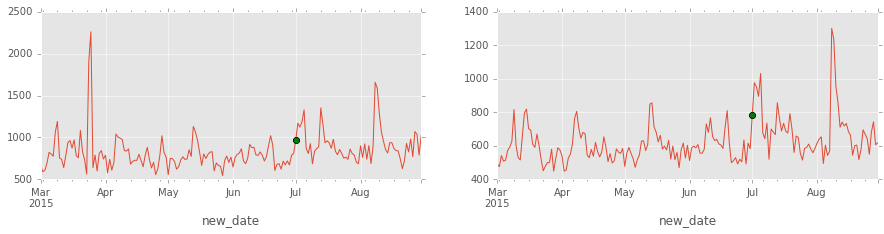

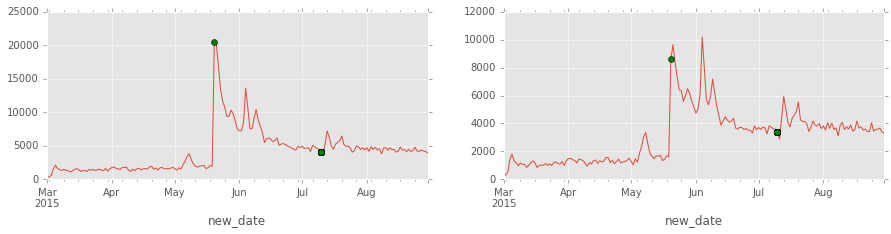

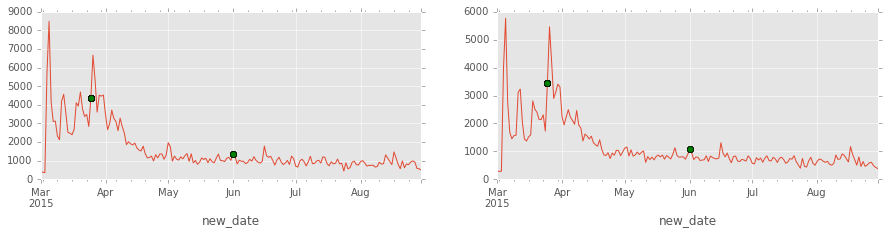

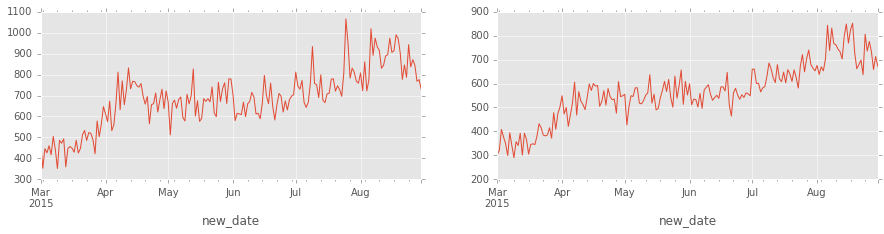

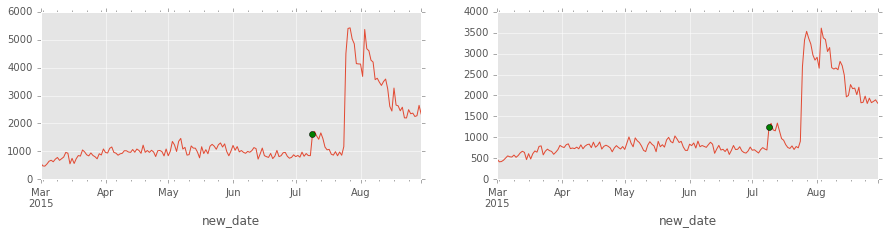

...

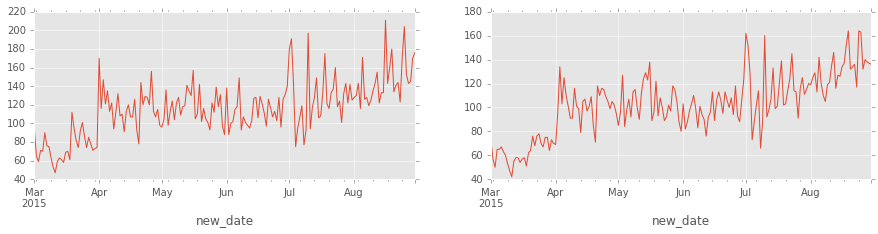

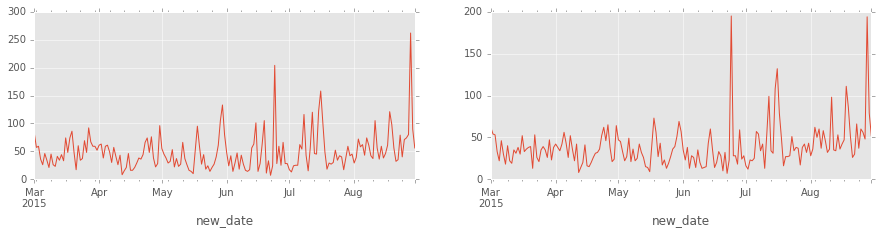

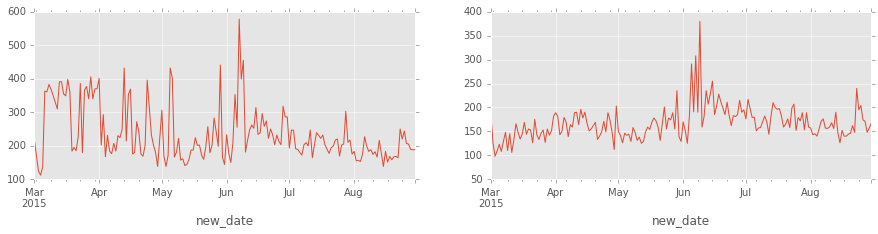

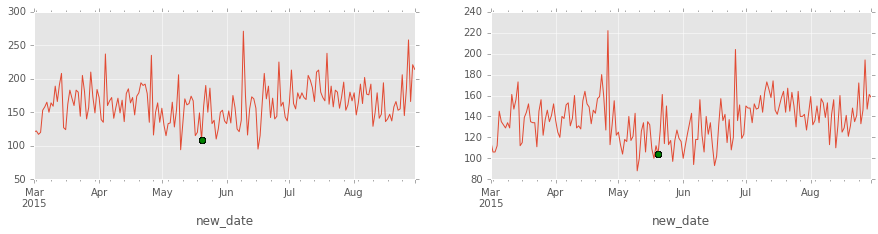

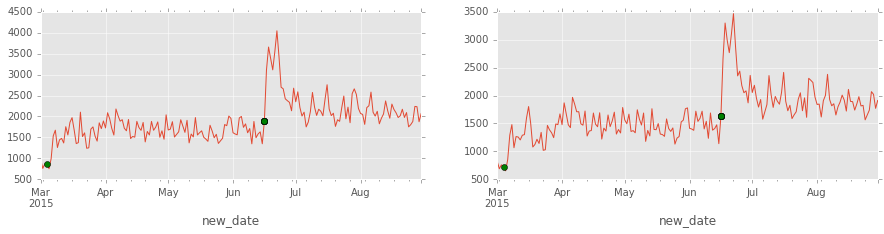

In [19]:
for artist in artists:
    fig = plt.figure(figsize = (15,3))
    ax1 = fig.add_subplot(1,2,1)
    ax2 = fig.add_subplot(1,2,2)
    # 获取歌手数据
    origin = df_daily_by_artist[df_daily_by_artist.artist_id == artist]
    origin['new_date'] = dates_past
    origin = origin.set_index(['new_date'])
    drop = df_daily_by_artist_drop[df_daily_by_artist_drop.artist_id == artist]
    drop['new_date'] = dates_past
    drop = drop.set_index(['new_date'])
    # 提取艺人在3月到8月的发片记录
    pub_info = df_song_info[df_song_info.artist_id == artist]
    pub_info = pub_info[(pub_info.public_time >= 20150301) & (pub_info.public_time <= 20150830)]
    pub_info = pub_info['public_time'].sort_values(inplace = False, ascending = False)
    # 画
    origin['play'].plot(ax = ax1)
    drop['play'].plot(ax = ax2)
    for pub_date in pub_info:
        origin[origin.date == pub_date]['play'].plot(ax = ax1, color = 'green', marker = 'o')
        drop[drop.date == pub_date]['play'].plot(ax = ax2, color = 'green', marker = 'o')
    fig.savefig('./image/p2/daily_by_artist_drop/%s.jpg' % artist)

In [78]:
data_song = get_daily_by_song(df_user_actions, '62303d7ab569b6c167587759dd61edfd')
data_song['new_date'] = dates_past
data_song = data_song.set_index(['new_date'])
data_song_droped = get_daily_by_song(df_user_actions_droped, '62303d7ab569b6c167587759dd61edfd')
data_song_droped['new_date'] = dates_past
data_song_droped = data_song_droped.set_index(['new_date'])

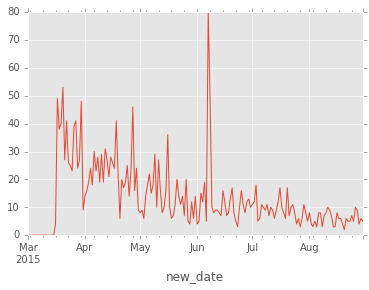

In [79]:
data_song['play'].plot(title = data_son)

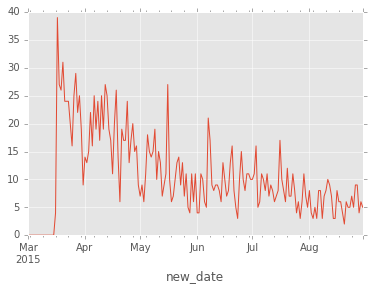

In [80]:
data_song_droped['play'].plot()

观察gmt_create属性，发现数据是精确到小时级别的

unix时间戳转换用time.localtime(1426348800)，得到time.struct_time(tm_year=2015, tm_mon=3, tm_mday=15, tm_hour=0, tm_min=0, tm_sec=0, tm_wday=6, tm_yday=74, tm_isdst=0)

引用的时候，可以用object.tm_mday得到

In [34]:
gmt_create = df_user_actions.gmt_create

temp1 = gmt_create.sort(inplace = False)

temp2 = set(list(temp1))

print len(temp1)

print len(temp2)

/home/yli/anaconda2/lib/python2.7/site-packages/ipykernel/__main__.py:3: FutureWarning: sort is deprecated, use sort_values(inplace=True) for INPLACE sorting
  app.launch_new_instance()


15884087
4392


**对每个歌手播放曲线画图**

/home/yli/anaconda2/lib/python2.7/site-packages/ipykernel/__main__.py:19: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: http://pandas.pydata.org/pandas-docs/stable/indexing.html#indexing-view-versus-copy
/home/yli/anaconda2/lib/python2.7/site-packages/matplotlib/pyplot.py:516: RuntimeWarning: More than 20 figures have been opened. Figures created through the pyplot interface (`matplotlib.pyplot.figure`) are retained until explicitly closed and may consume too much memory. (To control this warning, see the rcParam `figure.max_open_warning`).
  max_open_warning, RuntimeWarning)


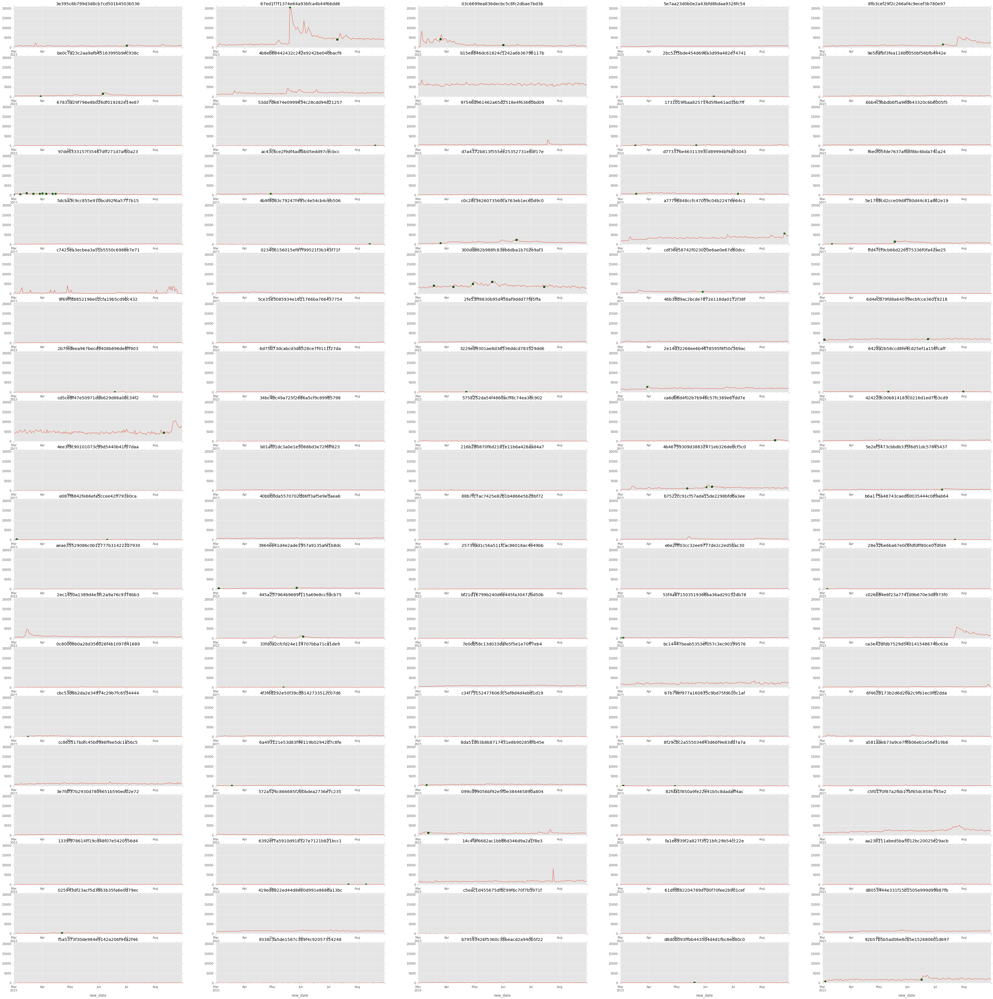

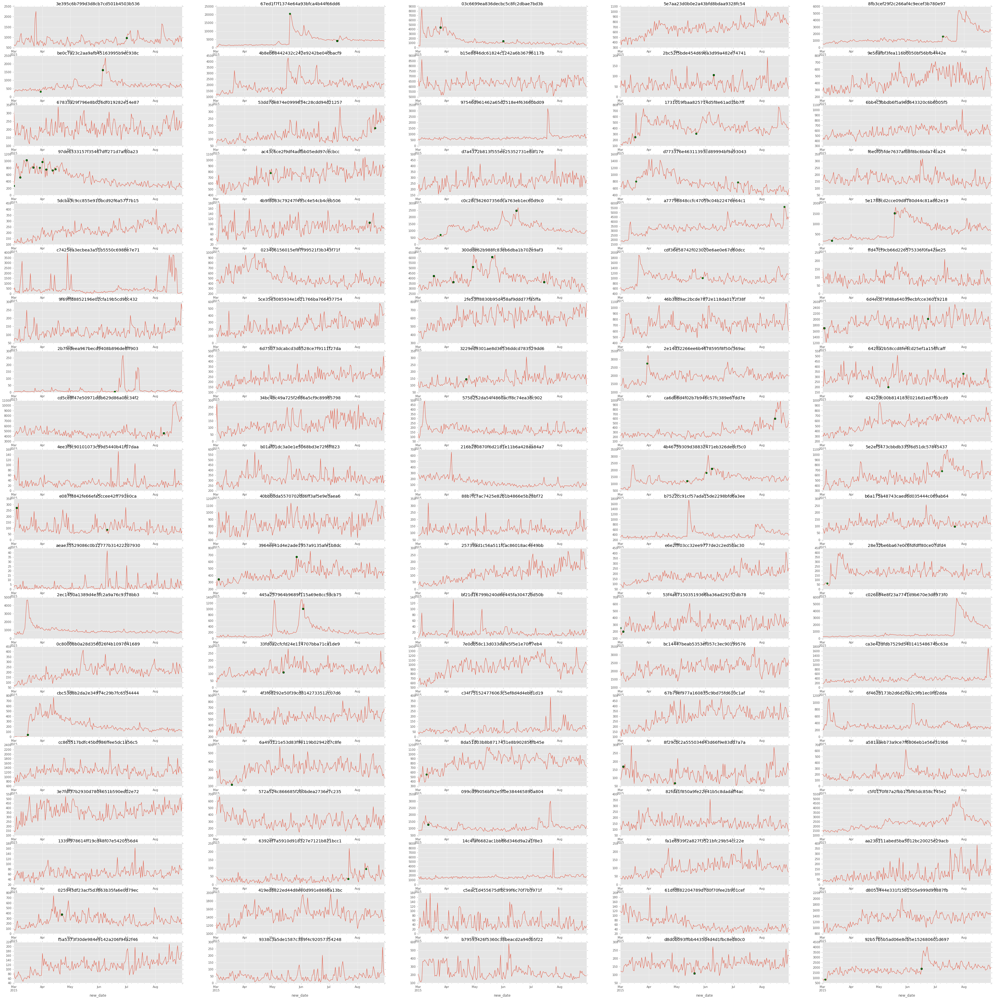

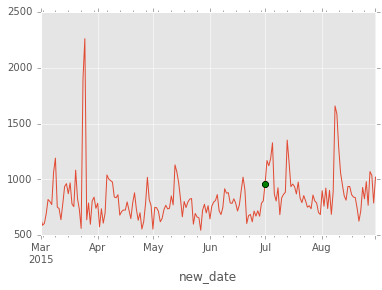

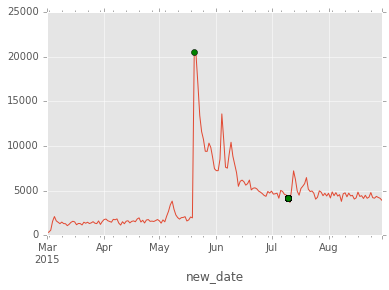

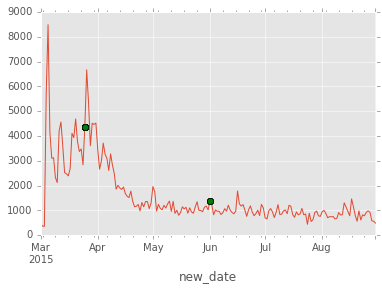

...

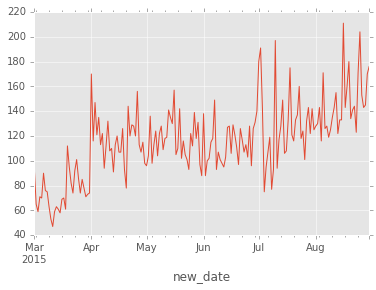

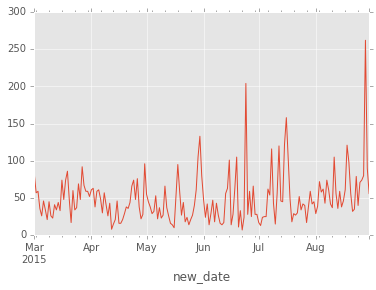

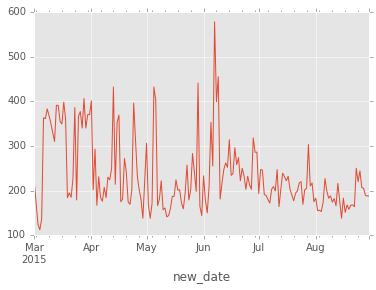

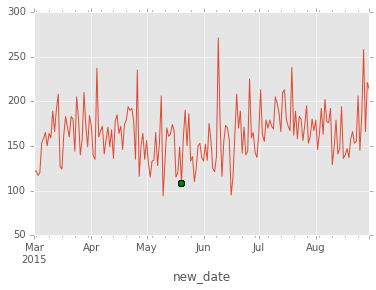

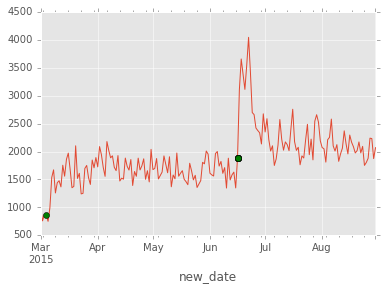

In [22]:
fig1 = plt.figure(figsize = (60, 60))
fig2 = plt.figure(figsize = (60, 60))
i = 1
for artist in artists:
    # 设定画布
#     sub_fig = plt.figure()
#     sub_ax = sub_fig.add_subplot(1,1,1)
    sub_ax1 = fig1.add_subplot(20, 5, i)
    sub_ax2 = fig2.add_subplot(20, 5, i)
    sub_ax1.set_ylim([0, 21000])
    sub_ax1.set_title(artist)
    sub_ax2.set_title(artist)
    # 提取艺人在3月到8月的发片记录
    pub_info = df_song_info[df_song_info.artist_id == artist]
    pub_info = pub_info[(pub_info.public_time >= 20150301) & (pub_info.public_time <= 20150830)]
    pub_info = pub_info['public_time'].sort_values(inplace = False, ascending = False)
    # 提取指定艺人的数据
    temp = df_daily_by_artist[df_daily_by_artist.artist_id == artist]
    temp['new_date'] = dates_past.tolist()
    temp = temp.set_index(['new_date'])
    temp['play'].plot(ax = sub_ax1)
    temp['play'].plot(ax = sub_ax2)
#     temp['play'].plot(ax = sub_ax)
    for pub_date in pub_info:
        the_data = temp[temp.date == pub_date]['play']
        the_data.plot(ax = sub_ax1, color = 'green', marker = 'o')
        the_data.plot(ax = sub_ax2, color = 'green', marker = 'o')
#         the_data.plot(ax = sub_ax, color = 'green', marker = 'o')
    # 增加画布序号
#     sub_fig.savefig('./image/p2/daily_by_artist/%s.jpg' % artist)
    i += 1
# fig1.savefig('./image/p2/daily_by_artist_normalize.jpg')
# fig2.savefig('./image/p2/daily_by_artist.jpg')

对有发新歌的歌手进行分析

In [2]:
temp_song = artists['cbc53d8b2da2e34974c29b7fc6534444']

In [3]:
temp_song

['93cb8ba74bba8a364089a078a1cde535',
 '8def190d4dd27d48bcbf804c51396207',
 '386229e5604dcf377178c65c1d6e7afa',
 '62303d7ab569b6c167587759dd61edfd',
 'a3ad895a26e26faac2b2c7ebda79955e',
 '6a0e1887120f654ed701be25a22cf501',
 '1dedf638b49834ff268190b6022e2025',
 '79d83749d4aaa14e06ed99e79c878560',
 'bcff0374e8fd6ece0a5d3658e41b9634',
 'b0f52b238e0a1e1951747fcb8e0d66e4',
 '927752f551a5d27a7fdadc18e1d0d993']

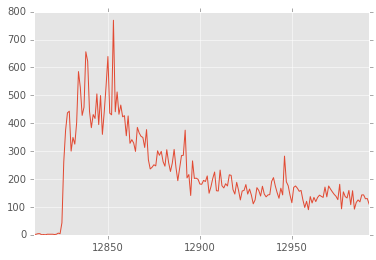

In [5]:
temp_data = df_daily_by_artist[df_daily_by_artist.artist_id == 'cbc53d8b2da2e34974c29b7fc6534444']

temp_data['play'].plot()

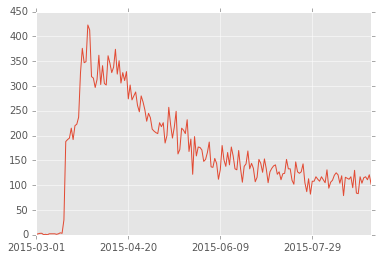

In [6]:
temp_data_drop = df_daily_by_artist_drop[df_daily_by_artist_drop.artist_id == 'cbc53d8b2da2e34974c29b7fc6534444']

temp_data_drop['play'].plot()

发现这个歌手在3月16好发了好多歌

/home/yli/anaconda2/lib/python2.7/site-packages/ipykernel/__main__.py:6: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: http://pandas.pydata.org/pandas-docs/stable/indexing.html#indexing-view-versus-copy


93cb8ba74bba8a364089a078a1cde535
8def190d4dd27d48bcbf804c51396207
386229e5604dcf377178c65c1d6e7afa
62303d7ab569b6c167587759dd61edfd
a3ad895a26e26faac2b2c7ebda79955e
6a0e1887120f654ed701be25a22cf501
1dedf638b49834ff268190b6022e2025
79d83749d4aaa14e06ed99e79c878560
bcff0374e8fd6ece0a5d3658e41b9634
b0f52b238e0a1e1951747fcb8e0d66e4
927752f551a5d27a7fdadc18e1d0d993


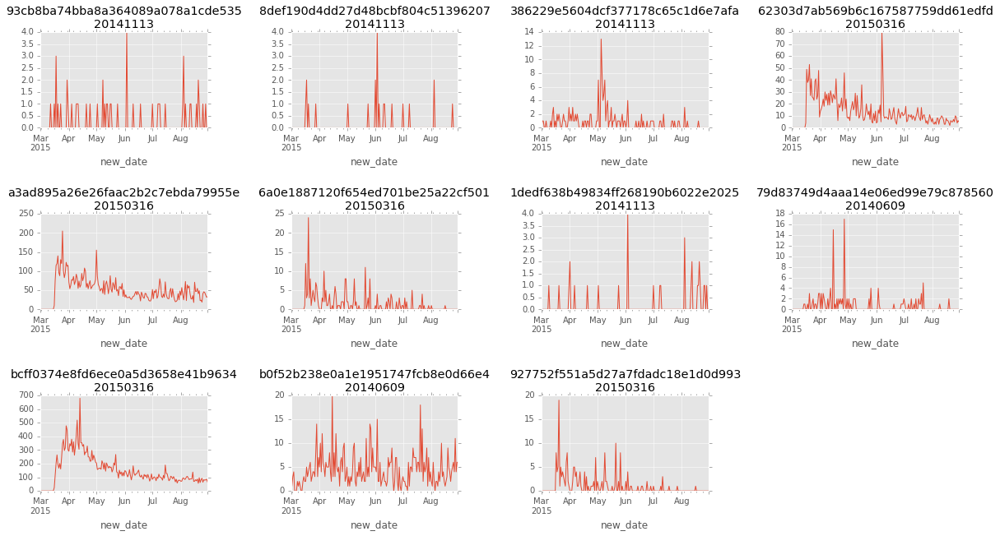

In [41]:
# 原始数据
fig = plt.figure(figsize = (20, 10))
i = 1
for song in temp_song:
    ax = fig.add_subplot(int(len(temp_song)/4)+1, 4, i)
    temp = df_daily_by_song[df_daily_by_song.song_id == song]
    temp['new_date'] = dates_past
    temp = temp.set_index(['new_date'])
    temp.play.plot(ax = ax)
    title = song + '\n' + str(int(df_song_info[df_song_info.song_id == song]['public_time']))
    ax.set_title(title)
    print song
    i += 1
plt.subplots_adjust(wspace = 0.5, hspace = 0.9)

/home/yli/anaconda2/lib/python2.7/site-packages/ipykernel/__main__.py:6: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: http://pandas.pydata.org/pandas-docs/stable/indexing.html#indexing-view-versus-copy


93cb8ba74bba8a364089a078a1cde535
8def190d4dd27d48bcbf804c51396207
386229e5604dcf377178c65c1d6e7afa
62303d7ab569b6c167587759dd61edfd
a3ad895a26e26faac2b2c7ebda79955e
6a0e1887120f654ed701be25a22cf501
1dedf638b49834ff268190b6022e2025
79d83749d4aaa14e06ed99e79c878560
bcff0374e8fd6ece0a5d3658e41b9634
b0f52b238e0a1e1951747fcb8e0d66e4
927752f551a5d27a7fdadc18e1d0d993


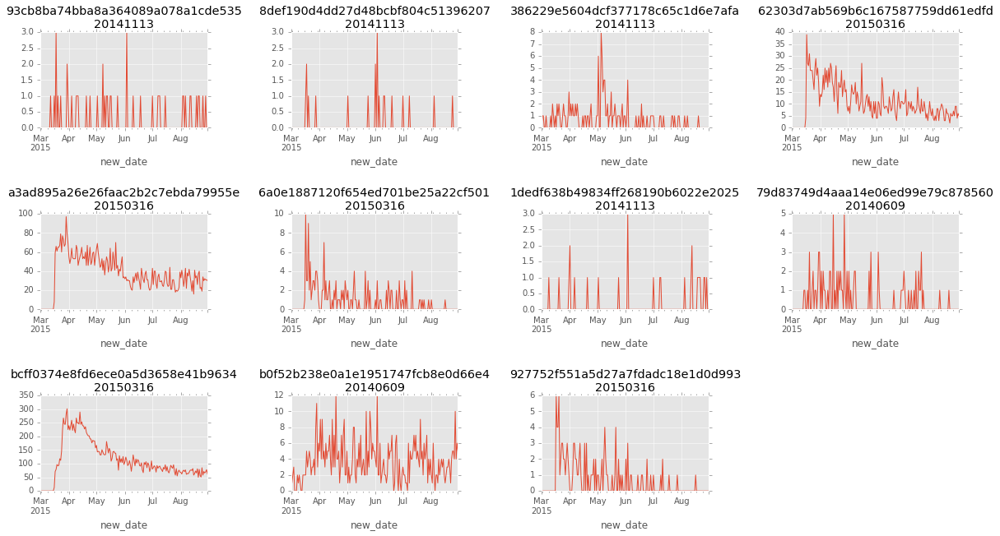

In [7]:
# 去重数据
fig = plt.figure(figsize = (20, 10))
i = 1
for song in temp_song:
    ax = fig.add_subplot(int(len(temp_song)/4)+1, 4, i)
    temp = df_daily_by_song_drop[df_daily_by_song_drop.song_id == song]
    temp['new_date'] = dates_past
    temp = temp.set_index(['new_date'])
    temp.play.plot(ax = ax)
    title = song + '\n' + str(int(df_song_info[df_song_info.song_id == song]['public_time']))
    ax.set_title(title)
    print song
    i += 1
plt.subplots_adjust(wspace = 0.5, hspace = 0.9)

/home/yli/anaconda2/lib/python2.7/site-packages/ipykernel/__main__.py:6: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: http://pandas.pydata.org/pandas-docs/stable/indexing.html#indexing-view-versus-copy


93cb8ba74bba8a364089a078a1cde535
8def190d4dd27d48bcbf804c51396207
386229e5604dcf377178c65c1d6e7afa
62303d7ab569b6c167587759dd61edfd
a3ad895a26e26faac2b2c7ebda79955e
6a0e1887120f654ed701be25a22cf501
1dedf638b49834ff268190b6022e2025
79d83749d4aaa14e06ed99e79c878560
bcff0374e8fd6ece0a5d3658e41b9634
b0f52b238e0a1e1951747fcb8e0d66e4
927752f551a5d27a7fdadc18e1d0d993


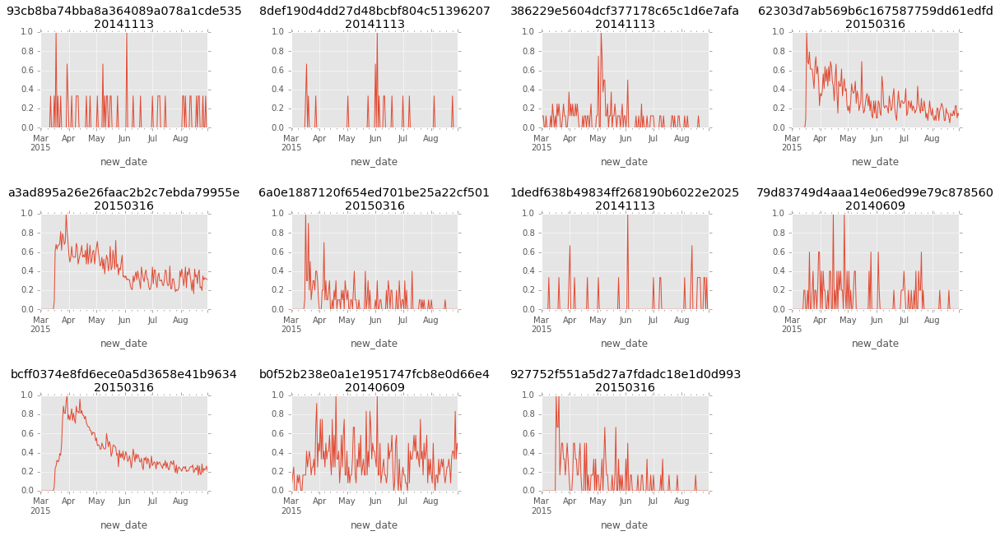

In [22]:
# 去重数据归一化处理
fig = plt.figure(figsize = (20, 10))
i = 1
for song in temp_song:
    ax = fig.add_subplot(int(len(temp_song)/4)+1, 4, i)
    temp = df_daily_by_song_drop[df_daily_by_song_drop.song_id == song]
    temp['new_date'] = dates_past
    temp = temp.set_index(['new_date'])
    temp_play_norm = min_max_normalization(temp['play'])
    temp_play_norm.plot(ax = ax)
    title = song + '\n' + str(int(df_song_info[df_song_info.song_id == song]['public_time']))
    ax.set_title(title)
    print song
    i += 1
plt.subplots_adjust(wspace = 0.5, hspace = 0.9)

In [33]:
db.core_sample_indices_

array([ 0,  1,  2,  3,  4,  5,  6,  7,  8, 10])

In [34]:
db.components_

array([[ 0],
       [ 1],
       [ 2],
       [ 3],
       [ 4],
       [ 5],
       [ 6],
       [ 7],
       [ 8],
       [10]])

In [50]:
song1 = df_daily_by_song_drop[df_daily_by_song_drop.song_id == '62303d7ab569b6c167587759dd61edfd']
song2 = df_daily_by_song_drop[df_daily_by_song_drop.song_id == 'a3ad895a26e26faac2b2c7ebda79955e']
song3 = df_daily_by_song_drop[df_daily_by_song_drop.song_id == 'bcff0374e8fd6ece0a5d3658e41b9634']

song4 = df_daily_by_song[df_daily_by_song.song_id == '62303d7ab569b6c167587759dd61edfd']
song5 = df_daily_by_song[df_daily_by_song.song_id == 'a3ad895a26e26faac2b2c7ebda79955e']
song6 = df_daily_by_song[df_daily_by_song.song_id == 'bcff0374e8fd6ece0a5d3658e41b9634']

print 'song_compare'
print song_compare(song1, song2), song_compare(song1, song3), song_compare(song2, song3)
# print song_compare(song4, song5), song_compare(song4, song6), song_compare(song5, song6)

print 'song_compare2'
print song_compare2(song1, song2), song_compare2(song1, song3), song_compare2(song2, song3)
# print song_compare2(song4, song5), song_compare2(song4, song6), song_compare2(song5, song6)

song_compare
25.582606397 27.6599369623 18.0538753982
song_compare2
20.1128733809 19.4659681404 14.8162482447


分析62303d7ab569b6c167587759dd61edfd这首歌激增的原因

后来发现是一个用户一直在听

In [52]:
temp_user = df_user_actions.loc[(df_user_actions.song_id == '62303d7ab569b6c167587759dd61edfd')
                         & (df_user_actions.user_id == 'dc765ee170ea8f9e4f58d79f1508ec01'),
                                ['user_id', 'action_type', 'gmt_create', 'Ds']]

In [53]:
temp_user = temp_user.sort_values(by = 'gmt_create')

In [54]:
temp_user

,user_id,action_type,gmt_create,Ds
7356722,dc765ee170ea8f9e4f58d79f1508ec01,2,1433408400,20150604
7356721,dc765ee170ea8f9e4f58d79f1508ec01,2,1433408400,20150604
7356728,dc765ee170ea8f9e4f58d79f1508ec01,1,1433422800,20150604
7356724,dc765ee170ea8f9e4f58d79f1508ec01,1,1433426400,20150604
7356723,dc765ee170ea8f9e4f58d79f1508ec01,1,1433426400,20150604
7356727,dc765ee170ea8f9e4f58d79f1508ec01,1,1433430000,20150604
7356726,dc765ee170ea8f9e4f58d79f1508ec01,1,1433430000,20150604
9150053,dc765ee170ea8f9e4f58d79f1508ec01,1,1433433600,20150605
9150050,dc765ee170ea8f9e4f58d79f1508ec01,1,1433433600,20150605
9150055,dc765ee170ea8f9e4f58d79f1508ec01,1,1433433600,20150605


**评测函数**

![score function](https://img.alicdn.com/tps/TB12LRiMXXXXXbKaXXXXXXXXXXX-801-341.png)

In [51]:
def score_fuc(date_from, date_to, file_predict, file_origin = './data/p2/daily_by_artist.csv'):
    df_origin = pd.read_csv(file_origin, 
                             header = None, 
                             names = ['date', 'play', 'download', 'like', 'artist_id'])
    df_origin['date'] = df_origin['date'].apply(lambda x:int(x[:4]+x[5:7]+x[8:]))
    df_predict = pd.read_csv(file_predict, 
                             header = None, 
                             names = ['artist_id', 'play', 'date'])
    artist_list = list(set(df_predict['artist_id']))
    F = 0
    for artist in artist_list:
        variance = 0
        weight = 0
        data_origin = df_origin[(df_origin.artist_id == artist) ]
        data_predict = df_predict[df_predict.artist_id == artist]
        data_origin = data_origin[(data_origin.date >= date_from)
                                & (data_origin.date <= date_to)]
        print data_origin         
        print data_predict
        S = []
        T = []
        for i in range(len(data_predict)):
            S.append(data_predict.iloc[i]['play'])
            T.append(int(data_origin[data_origin.date == data_predict.iloc[i]['date']]['play']))
        print S
        print T
        for s,t in zip(S, T):
            weight += t
            variance += (((s-t)/t) * ((s-t)/t))
        weight = math.sqrt(weight)
        variance = math.sqrt(variance/len(data_predict))
        F += (1 - variance) * weight
    return F  

In [54]:
# dates = pd.date_range('20150829', '20150830')
# for artist in artist_id:
#     data = df_song_by_artist[df_song_by_artist['artist_id'] == artist][-7:-2]
#     data_mean = data.mean(axis = 0)
#     data_mean_play = data_mean['play']
#     temp = pd.DataFrame(data={'artist_id':artist, 'play':int(data_mean_play)}, 
#                         index=dates)
#     temp['date'] = dates
#     temp.to_csv('./output/try_predict_last_week.csv', mode = 'a', encoding='utf-8',
#                 date_format = "%Y%m%d", index = False,header = False)

In [55]:
# f = score_fuc(20150829, 20150830, './output/try_predict_last_week.csv')

         date  play  download  like                         artist_id
181  20150829    58         9     5  e087f8842fe66efa5ccee42ff791e0ca
182  20150830    77         8     0  e087f8842fe66efa5ccee42ff791e0ca
                          artist_id  play      date
0  e087f8842fe66efa5ccee42ff791e0ca    75  20150829
1  e087f8842fe66efa5ccee42ff791e0ca    75  20150830
[75, 75]
[58, 77]
         date  play  download  like                         artist_id
364  20150829   788        81     3  3e395c6b799d3d8cb7cd501b4503b536
365  20150830  1020       104     7  3e395c6b799d3d8cb7cd501b4503b536
                          artist_id  play      date
2  3e395c6b799d3d8cb7cd501b4503b536   936  20150829
3  3e395c6b799d3d8cb7cd501b4503b536   936  20150830
[936, 936]
[788, 1020]
         date  play  download  like                         artist_id
547  20150829   749        89    14  8da51d03b8b8717431e8b902856fb45e
548  20150830   726       112     8  8da51d03b8b8717431e8b902856fb45e
                 

In [56]:
# f

1066.867744264954

**星期统计**

- 对未处理数据，按照单个歌手，分析每星期的播放数据

In [3]:
# 对按照艺人统计的数据，增加“星期”特征列
df_daily_by_artist['w_day'] = df_daily_by_artist['date'].apply(get_wday_from_date)
# 对按照艺人统计的去重数据，增加“星期”特征列
df_daily_by_artist_drop['w_day'] = df_daily_by_artist_drop['date'].apply(get_wday_from_date)

In [4]:
# 统计每个星期对应的总播放量
data_w_day = {}
for artist in artists:
    data_w_day[artist] = [0,0,0,0,0,0,0]
    temp = df_daily_by_artist[df_daily_by_artist.artist_id == artist][-42:]
    play = list(temp['play'])
    w_day = list(temp['w_day'])
    i = 0
    for item in w_day:
        data_w_day[artist][item-1] += int(play[i])
        i += 1
# 统计去重数据的每个星期对应的总播放量
data_w_day_drop = {}
for artist in artists:
    data_w_day_drop[artist] = [0,0,0,0,0,0,0]
    temp = df_daily_by_artist_drop[df_daily_by_artist_drop.artist_id == artist][-42:]
    play = list(temp['play'])
    w_day = list(temp['w_day'])
    i = 0
    for item in w_day:
        data_w_day_drop[artist][item-1] += int(play[i])
        i += 1

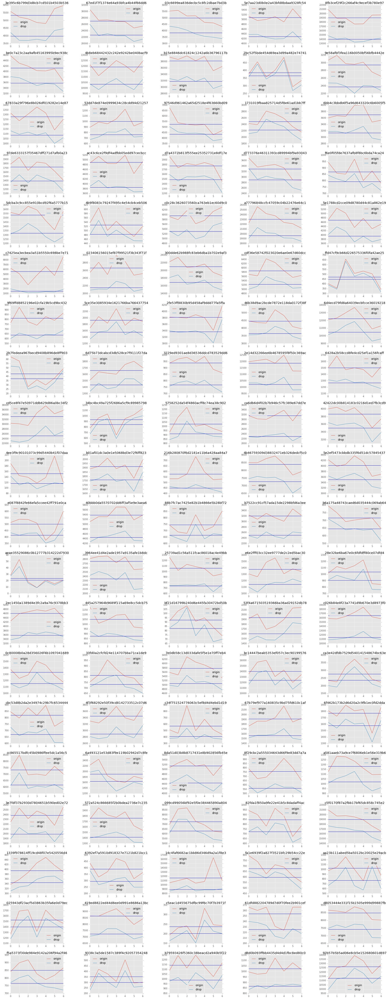

In [5]:
fig = plt.figure(figsize = (30, 80))
i = 1
trend_week = {}
trend_week_drop = {}
for artist in artists:
    trend_week[artist] = []
    trend_week_drop[artist] = []
    ax = fig.add_subplot(20, 5, i)
    # normal
    play = data_w_day[artist]
    df = pd.Series(data = play)
    df.plot(ax = ax, title = artist, label = 'origin', legend = True)
    avg = df.mean()
    ax.axhline(avg, label = 'origin')
    # drop
    play_drop = data_w_day_drop[artist]
    df_drop = pd.Series(data = play_drop)
    df_drop.plot(ax = ax, label = 'drop', legend = True)
    avg_drop = df_drop.mean()
    ax.axhline(avg_drop, label = 'drop')
       
    for j in range(0,7):
        trend_week[artist].append((df.iloc[j] - avg)/avg)
        trend_week_drop[artist].append((df_drop.iloc[j] - avg_drop)/avg_drop)
    
    i+=1
plt.subplots_adjust(wspace = 0.5, hspace = 0.3)
# fig.savefig('image/w_day_artist.png')

In [14]:
fig.savefig('image/p2/w_day_artist.jpg')

8天平均，再加上星期的趋势做扰动（原始数据）

In [6]:
for artist in artists:
    data = df_daily_by_artist[df_daily_by_artist.artist_id == artist][-8:]
    data_mean = data.mean(axis = 0)
    data_mean_play = data_mean['play']
    data_week = []
    for i in range(0, 7):
        data_week.append(int(data_mean_play * (1 + trend_week[artist][i]*0.2)))
#     print data_mean_play, data_week
    count = 0
    week_day = 1
    data_temp = []
    while count < 60:
        week_day = week_day % 7
        data_temp.append(data_week[week_day])
        week_day += 1
        count += 1
    
    temp = pd.DataFrame(data={'artist_id':artist, 'play':data_temp}, index=dates_future)
    temp['date']=dates_future
    temp.to_csv('./output/p2/mean_by_artist_august_last8days_plus_week_trend_20%.csv', mode = 'a', encoding='utf-8',
                date_format = "%Y%m%d", index = False,header = False)

8天平均，再加上星期的趋势做扰动

In [8]:
for artist in artists:
    data = df_daily_by_artist[df_daily_by_artist.artist_id == artist][-8:]
    data_mean = data.mean(axis = 0)
    data_mean_play = data_mean['play']
    data_week = []
    for i in range(0, 7):
        data_week.append(int(data_mean_play * (1 + trend_week_drop[artist][i]*0.2)))
#     print data_mean_play, data_week
    count = 0
    week_day = 1
    data_temp = []
    while count < 60:
        week_day = week_day % 7
        data_temp.append(data_week[week_day])
        week_day += 1
        count += 1
    
    temp = pd.DataFrame(data={'artist_id':artist, 'play':data_temp}, index=dates_future)
    temp['date']=dates_future
    temp.to_csv('./output/p2/mean_by_artist_august_last8days_plus_drop_week_trend.csv', mode = 'a', encoding='utf-8',
                date_format = "%Y%m%d", index = False,header = False)

- 统计所有歌手，每星期的播放数据

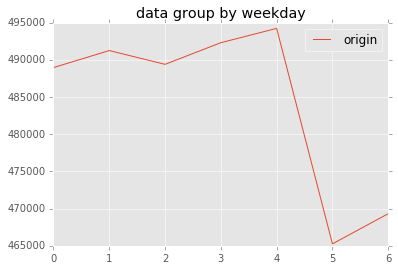

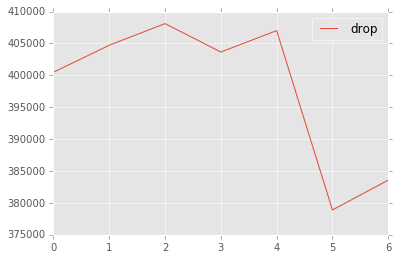

In [17]:
# 将之前每个歌手的星期播放数据相加
play_sum = [0,0,0,0,0,0,0]
play_sum_drop = [0,0,0,0,0,0,0]
for artist in data_w_day:
    play = data_w_day[artist]
    play_drop = data_w_day_drop[artist]
    for j in range(0, 7):
        play_sum[j] += play[j]
        play_sum_drop[j] += play_drop[j]
# 输出图像
fig = plt.figure()
pd.Series(data = play_sum).plot(title = "data group by weekday", label = 'origin', legend = True)
fig_drop = plt.figure()
pd.Series(data = play_sum_drop).plot(label = 'drop', legend = True)

- 单个歌手，统计所有星期的曲线叠加

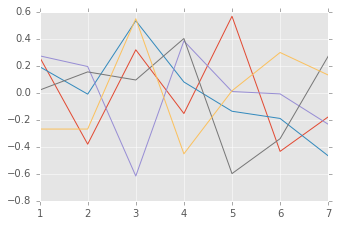

In [4]:
period = 42
fig = plt.figure(figsize = (30, 40))
plot_id = 1
for artist in artist_id[:1]:
    ax = fig.add_subplot(10, 5, plot_id)
    data_artist = df_song_by_artist[df_song_by_artist.artist_id == artist]
    for day in range(1, 183, period):
        j = day
        play_period = pd.Series(data=[0, 0, 0, 0, 0, 0, 0], index = [i for i in range(1,8)])
        while j < (day+period-1) and j < 183:
            data_week = data_artist.iloc[range(j, j+7)]
            data_week = data_week.set_index(['w_day'])['play']
            
            play_period = play_period + data_week       
#             print 'data_week', data_week
#             print 'j: ', j
            j += 7
        
        play_period = play_period.apply(lambda x : (x - np.mean(play_period)) / (np.max(play_period) - np.min(play_period)))
#         print 'play_period', play_period
        play_period.plot(ax = ax)
    plot_id += 1

**把8月最后8天、7天、6天数据做平均的结果比较**

In [65]:
df_mean_8 = pd.read_csv('./output/mean_by_artist_august_last8days.csv', 
                         header = None, 
                         names = ('artist_id', 'play', 'date'))
df_mean_7 = pd.read_csv('./output/mean_by_artist_august_last7days.csv', 
                         header = None, 
                         names = ('artist_id', 'play', 'date'))
df_mean_6 = pd.read_csv('./output/mean_by_artist_august_last6days.csv', 
                         header = None, 
                         names = ('artist_id', 'play', 'date'))

df_mean_8 = df_mean_8.iloc[[i for i in range(0, 3000, 60)]]
df_mean_7 = df_mean_7.iloc[[i for i in range(0, 3000, 60)]]
df_mean_6 = df_mean_6.iloc[[i for i in range(0, 3000, 60)]]

for i in range(0, 50):
    if df_mean_6.iloc[i]['artist_id'] != df_mean_7.iloc[i]['artist_id']:
        print 'not match in 6&7 :', i
    if df_mean_7.iloc[i]['artist_id'] != df_mean_8.iloc[i]['artist_id']:
        print 'not match in 7&8 :', i

df_67 = df_mean_6['play'] - df_mean_7['play']
df_68 = df_mean_6['play'] - df_mean_8['play']
df_78 = df_mean_7['play'] - df_mean_8['play']

In [66]:
play_abs_67 = []
for i in range(0, 50):
    temp = df_67.iloc[i]
    if temp > 0:
        play_abs_67.append(1)
    elif temp == 0:
        play_abs_67.append(0)
    elif temp < 0:
        play_abs_67.append(-1)
play_abs_67 = pd.Series(data = play_abs_67)

play_abs_68 = []
for i in range(0, 50):
    temp = df_68.iloc[i]
    if temp > 0:
        play_abs_68.append(1)
    elif temp == 0:
        play_abs_68.append(0)
    elif temp < 0:
        play_abs_68.append(-1)
play_abs_68 = pd.Series(data = play_abs_68)

play_abs_78 = []
for i in range(0, 50):
    temp = df_78.iloc[i]
    if temp > 0:
        play_abs_78.append(1)
    elif temp == 0:
        play_abs_78.append(0)
    elif temp < 0:
        play_abs_78.append(-1)
play_abs_78 = pd.Series(data = play_abs_78)

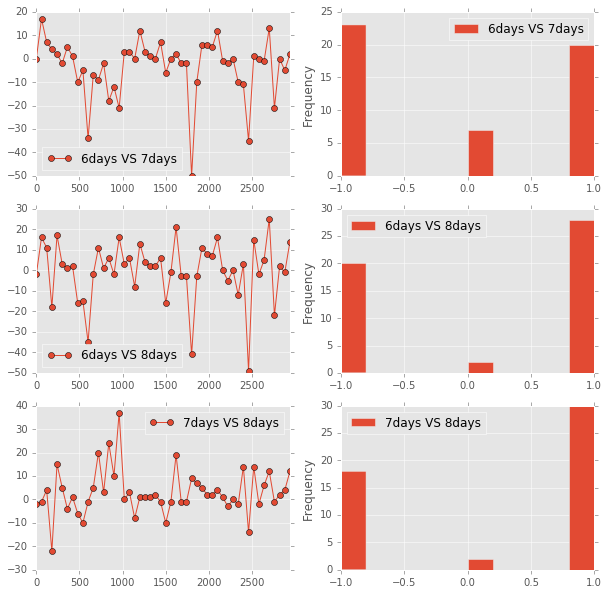

In [69]:
fig = plt.figure(figsize = (10,10))
ax = fig.add_subplot(3,2,1)
df_67.plot(ax = ax, label = '6days VS 7days', legend = True, marker = 'o')
ax = fig.add_subplot(3,2,2)
play_abs_67.plot(kind = 'hist', ax = ax, label = '6days VS 7days', legend = True)
ax = fig.add_subplot(3,2,3)
df_68.plot(ax = ax, label = '6days VS 8days', legend = True, marker = 'o')
ax = fig.add_subplot(3,2,4)
play_abs_68.plot(kind = 'hist', ax = ax, label = '6days VS 8days', legend = True)
ax = fig.add_subplot(3,2,5)
df_78.plot(ax = ax, label = '7days VS 8days', legend = True, marker = 'o')
ax = fig.add_subplot(3,2,6)
play_abs_78.plot(kind = 'hist', ax = ax, label = '7days VS 8days', legend = True)

** 将一首歌曲按照天分开，统计逐小时的播放量 **

- 为user_action表添加小时数据段

使用dataframe的apply方法，对一个Series进行操作，应用自定义的函数获取小时字段

In [6]:
def get_hour(time_value):
    time_value = time.localtime(time_value)
    return time_value.tm_hour

def get_wday(time_value):
    time_value = time.localtime(time_value)
    return time_value.tm_wday+1

In [7]:
df_user_actions['hour'] = df_user_actions['gmt_create'].apply(get_hour)
df_user_actions['week_day'] = df_user_actions['gmt_create'].apply(get_wday)

- 对单首歌曲进行分析

选择歌曲“ecea5fe33e6817d09c395f2910479728”

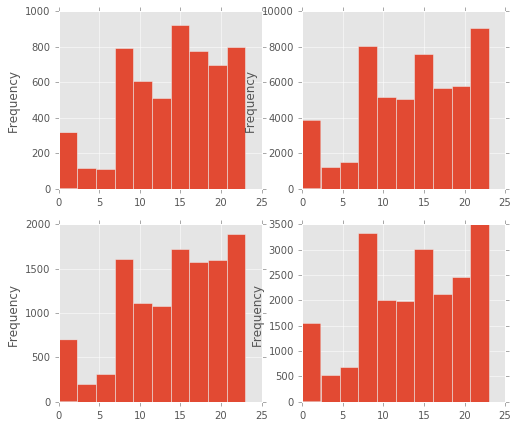

In [49]:
fig = plt.figure(figsize=(8, 7))

ax1 = fig.add_subplot(2, 2, 1)

df_user_actions[(df_user_actions.song_id == "ecea5fe33e6817d09c395f2910479728")
                                 & (df_user_actions.action_type == 1)]['hour'].plot.hist()

ax2 = fig.add_subplot(2, 2, 2)

df_user_actions[(df_user_actions.song_id == "8a27d9a6c59628c991c154e8d93f412e")
                                 & (df_user_actions.action_type == 1)]['hour'].plot.hist()

ax3 = fig.add_subplot(2, 2, 3)

df_user_actions[(df_user_actions.song_id == "31a3d0420d89c9b121bb55dbdbbeda6b")
                                 & (df_user_actions.action_type == 1)]['hour'].plot.hist()

ax4 = fig.add_subplot(2, 2, 4)

df_user_actions[(df_user_actions.song_id == "f87ff481d85d2f95335ab602f38a7655")
                                 & (df_user_actions.action_type == 1)]['hour'].plot.hist()

**分析周数据是否有规律**

- 分析每周是否有周期性规律，将同一个艺人的周数据叠加在同一张图上

**标注发片时间**

/home/yli/anaconda2/lib/python2.7/site-packages/ipykernel/__main__.py:19: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: http://pandas.pydata.org/pandas-docs/stable/indexing.html#indexing-view-versus-copy


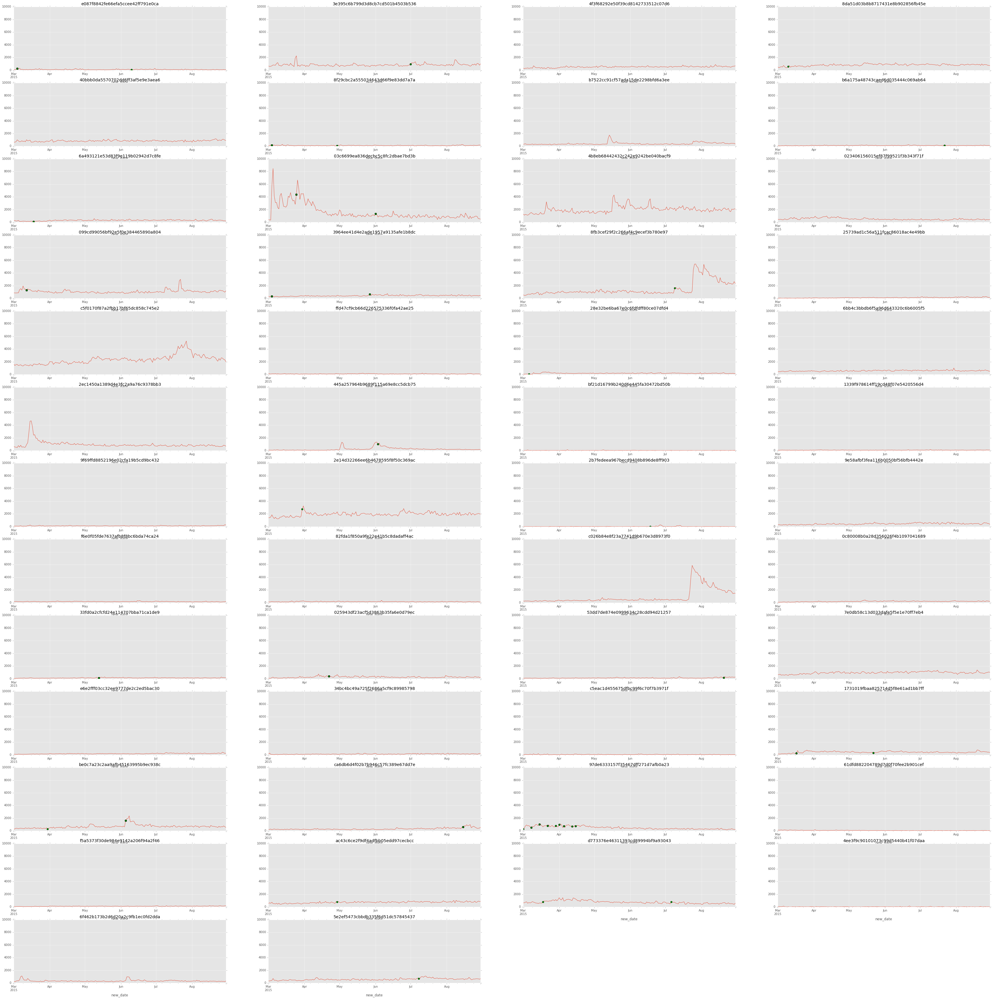

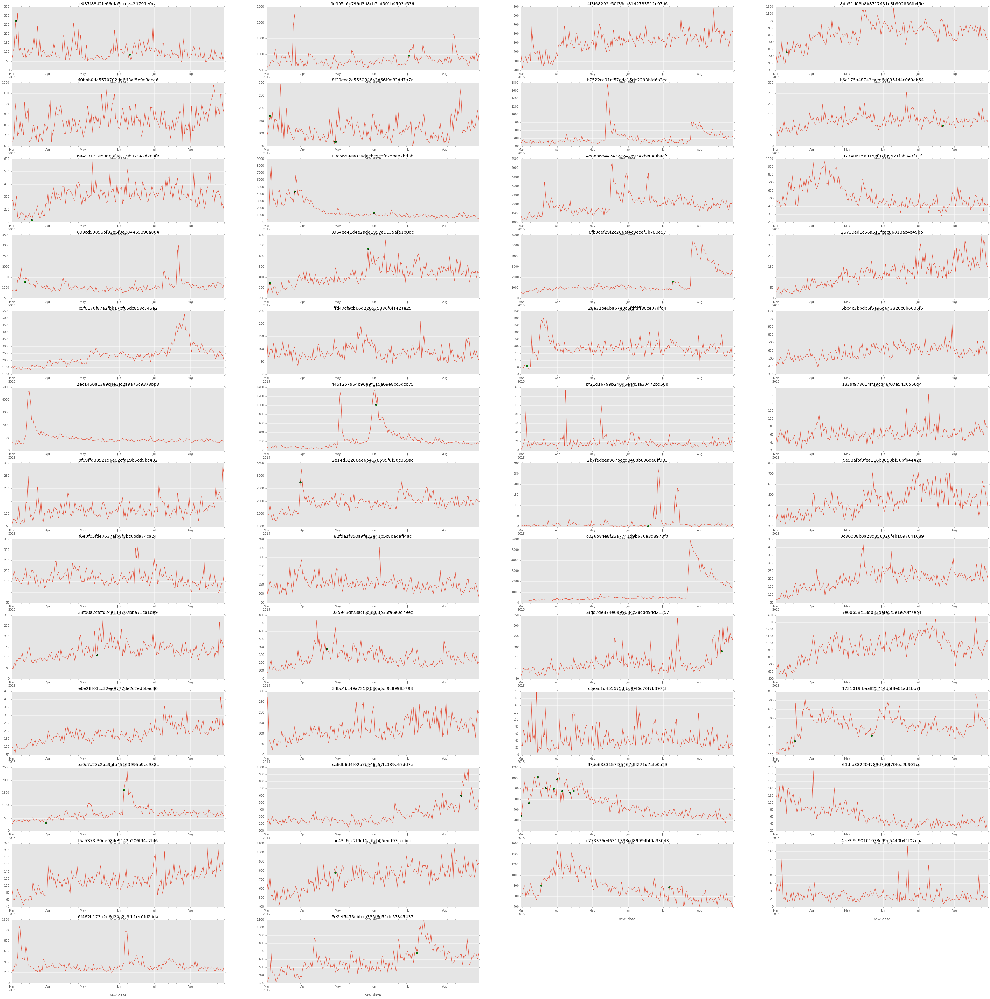

In [100]:
fig1 = plt.figure(figsize = (60, 60))
fig2 = plt.figure(figsize = (60, 60))
i = 1
for artist in artist_id[:]:
    # 设定画布
#     fig = plt.figure()
    sub_ax1 = fig1.add_subplot(13, 4, i)
    sub_ax2 = fig2.add_subplot(13, 4, i)
    sub_ax1.set_ylim([0, 10000])
    sub_ax1.set_title(artist)
    sub_ax2.set_title(artist)
    # 提取艺人在3月到8月的发片记录
    pub_info = df_song_info[df_song_info.artist_id == artist]
    pub_info = pub_info[(pub_info.public_time >= 20150301) & (pub_info.public_time <= 20150830)]
    pub_info = pub_info['public_time'].sort_values(inplace = False, ascending = False)
    # 提取指定艺人的数据
    temp = df_song_by_artist[df_song_by_artist.artist_id == artist]
    temp['new_date'] = date_past.tolist()
    temp = temp.set_index(['new_date'])
    temp['play'].plot(ax = sub_ax1)
    temp['play'].plot(ax = sub_ax2)
    for pub_date in pub_info:
        the_data = temp[temp.date == pub_date]['play']
        the_data.plot(ax = sub_ax1, color = 'green', marker = 'o')
        the_data.plot(ax = sub_ax2, color = 'green', marker = 'o')
#     sub_ax.figure.savefig('image/public&play_artist'+str(i)+'.png')
    # 增加画布序号
    i += 1
fig1.savefig('./image/1.jpg')
fig2.savefig('./image/2.jpg')

**统计播放量和下载量的相关性**

In [2]:
# artist_V = ['8fb3cef29f2c266af4c9ecef3b780e97', 'c026b84e8f23a7741d9b670e3d8973f0',
#             'c5f0170f87a2fbb17bf65dc858c745e2', '03c6699ea836decbc5c8fc2dbae7bd3b', 
#             '4b8eb68442432c242e9242be040bacf9', '2e14d32266ee6b4678595f8f50c369ac']

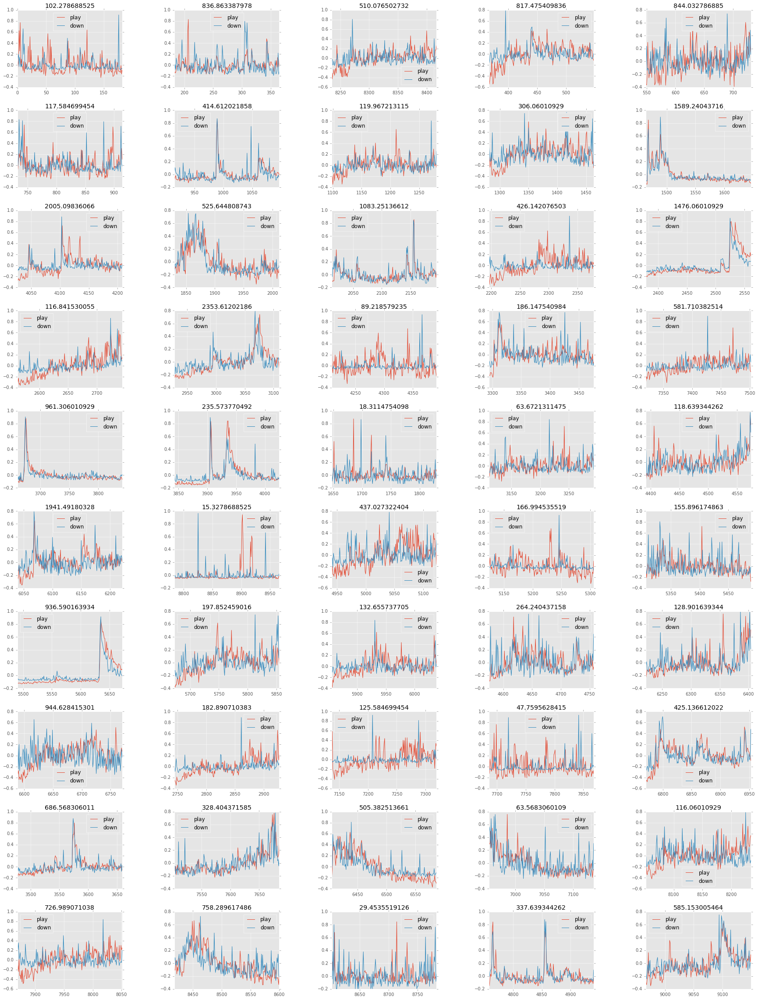

In [13]:
fig = plt.figure(figsize = (30, 40))
i = 1
for artist in artist_id:
    ax = fig.add_subplot(10, 5, i)
    temp = df_song_by_artist[df_song_by_artist.artist_id == artist]
    data_play = temp.play.apply(lambda x : (x - np.mean(temp.play)) / (np.max(temp.play) - np.min(temp.play)))
    data_play.plot(ax = ax, label = 'play', legend = True)
    data_down = temp.download.apply(lambda x : (x - np.mean(temp.download)) / (np.max(temp.download) - np.min(temp.download)))
    data_down.plot(ax = ax, label = 'down', legend = True)
    ax.set_title(np.mean(temp.play))
    
    i+=1
plt.subplots_adjust(wspace = 0.5, hspace = 0.3)
fig.savefig('image/song_artist_play_down.png')

**对单个歌手的歌曲进行聚类划分**

In [14]:
play = df_song_by_artist[df_song_by_artist.artist_id == '8fb3cef29f2c266af4c9ecef3b780e97']
info = df_song_info[df_song_info.artist_id == '8fb3cef29f2c266af4c9ecef3b780e97']

In [15]:
len(info)

22

**分析某位歌手的播放量**

In [ ]:
# get the data of a specific song
s = df_songs_by_day[['date', 'play', 'download', 'like']][df_songs_by_day['song_id'] == '3e721589da31c018bc2f7541e995f795']

# create the dates index
s['date'] = pd.date_range('20150301', '20150830').tolist()

s = s.set_index(['date'])

s.plot(figsize = (10,5))
# s.plot()

In [ ]:
# get the data of a specific song
s = df_songs_by_day[['date', 'play', 'download', 'like']][df_songs_by_day['song_id'] == '09ae793cae7c4e355800cd2320cb6c42']

# create the dates index
s['date'] = pd.date_range('20150301', '20150830').tolist()

s = s.set_index(['date'])

s.plot(figsize = (10,5))
# s.plot()

In [ ]:
df_songs_by_artist = pd.read_csv('./data/p2/songs_by_artist.csv', header = None, names = ['date', 'play', 'download', 'like', 'artist_id'])
len(set(df_songs_by_artist['artist_id']))

In [ ]:
df_songs_by_artist.describe()

In [ ]:
df_songs_by_artist

In [ ]:
a = df_songs_by_artist[['date', 'play', 'download', 'like']][df_songs_by_artist['artist_id'] == 
                                                                 '5e2ef5473cbbdb335f6d51dc57845437']
a = a.set_index(['date'])

plt.figure()
a.plot(figsize = (10,5))
ax = a.plot.scatter(x = 'download', y = 'play', color = 'blue', label = 'download-play')
a.plot.scatter(figsize = (10,5), x = 'like', y = 'play', color = 'red', label = 'like-play', ax = ax)